In [2]:
import numpy as np
import pandas as pd
from astropy.io import fits
import matplotlib.pyplot as plt
import astropy.visualization as visualization
import glob
import os
import time

In [2]:
# x=os.system('squeue -u arikhind -j 70034')
# def clear_output(wait=False):
#     print("\033[H\033[J", end="", flush=True)
#     if wait:
#         time.sleep(0.1)
# #every 5 seconds, check if the job is done
# while True:
#     time.sleep(120)
#     os.system('squeue -j 70033')#u arikhind')
#     #clear the output in the cell
#     clear_output(wait=True)



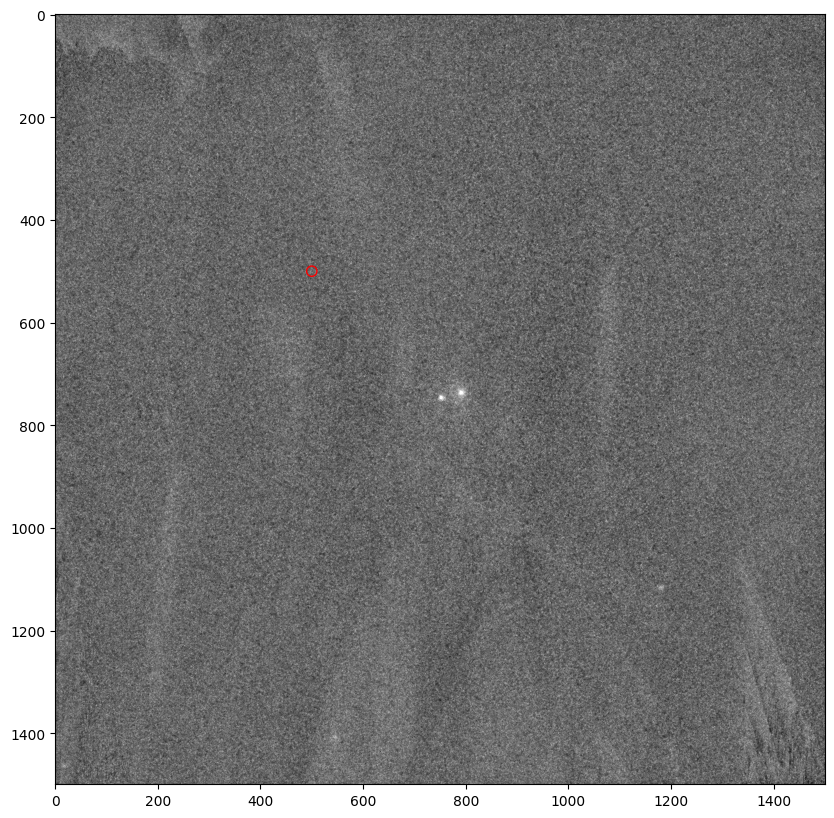

In [3]:
fig = plt.figure(figsize=(10, 10))
d = fits.open('/mnt/data1/users/arikhind/phot_data/aligned_images/ZTF24abyaspl_u2024-12-17_10698bkgsub.resamp.fits')[0].data#[700:800, 700:800]
vmin,vmax = visualization.ZScaleInterval().get_limits(d)

plt.imshow(d, cmap='gray', vmin=vmin, vmax=vmax)
#plot a hollow circle at 50,50 with radius 10
plt.gca().add_artist(plt.Circle((500, 500), 10, fill=False, edgecolor='red'))

In [ ]:
# fits_list = '24wpp_fits_list.csv'
# fits_df = pd.read_csv(fits_list)
fits_20241106 = glob.glob('/mnt/data1/users/arikhind/phot_data/NTT_2024wpp_raw/20241106_24wpp_phot/*.fits')
fits_20241107 = glob.glob('/mnt/data1/users/arikhind/phot_data/NTT_2024wpp_raw/20241107_24wpp_phot/*.fits')
fits_20241106_cal = glob.glob('/mnt/data1/users/arikhind/phot_data/NTT_2024wpp_raw/cal_20241106_24wpp/*.fits')
archive_ = glob.glob('/mnt/data1/users/arikhind/phot_data/NTT_2024wpp_raw/archive/*.fits')

/mnt/data1/users/arikhind/phot_data/24wpp/20241105/SN2024wpp_20241105_U640_60630_1.fits


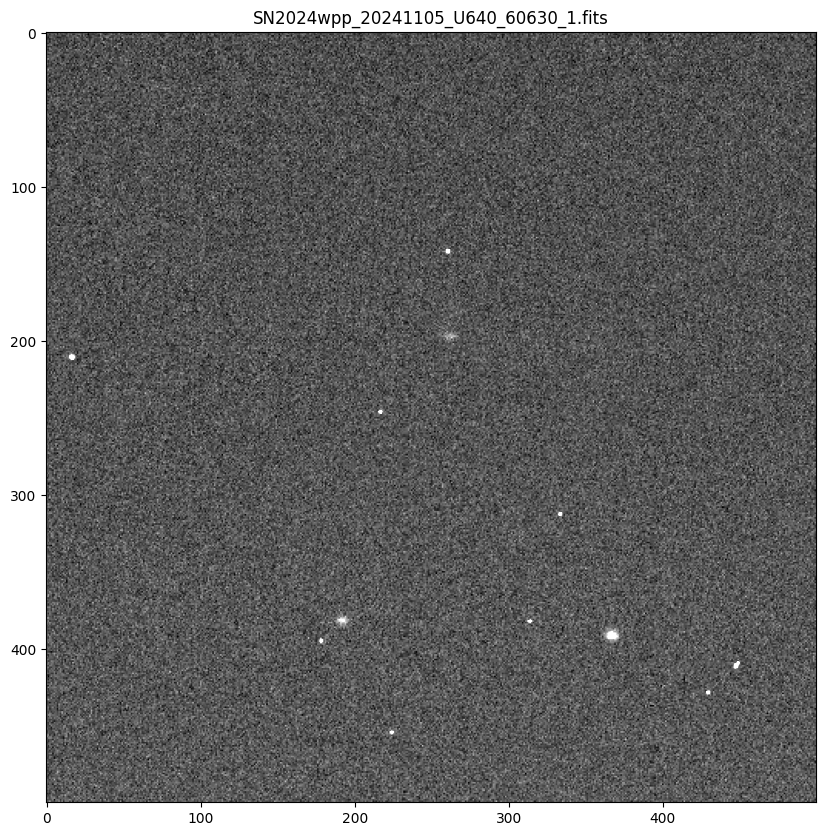

/mnt/data1/users/arikhind/phot_data/24wpp/20241105/SN2024wpp_20241105_U640_60630_2.fits


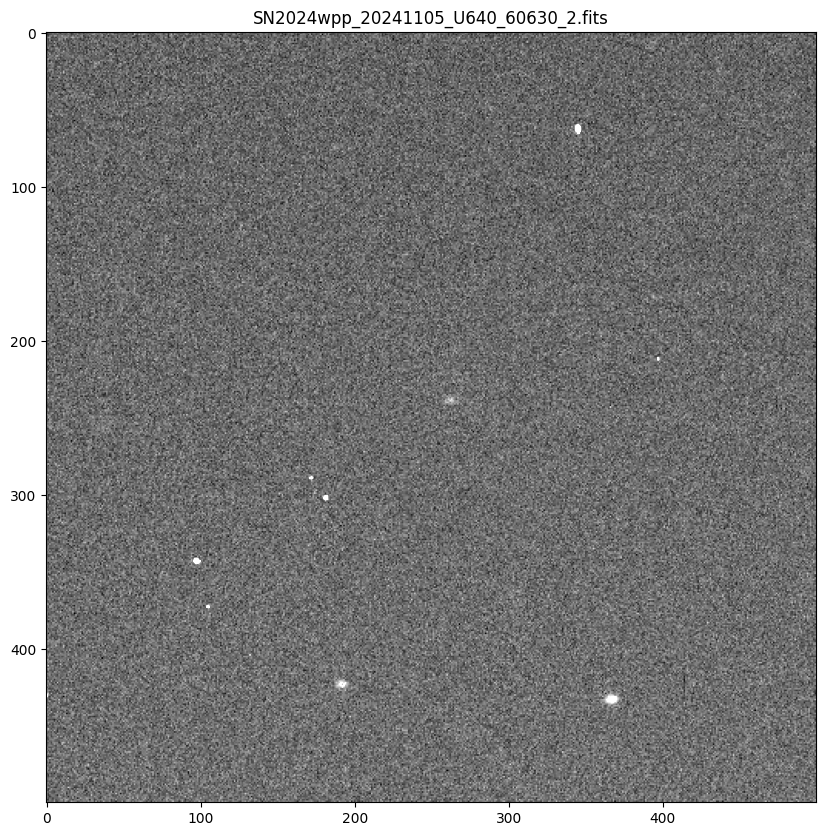

/mnt/data1/users/arikhind/phot_data/24wpp/20241105/SN2024wpp_20241105_U640_60630_3.fits


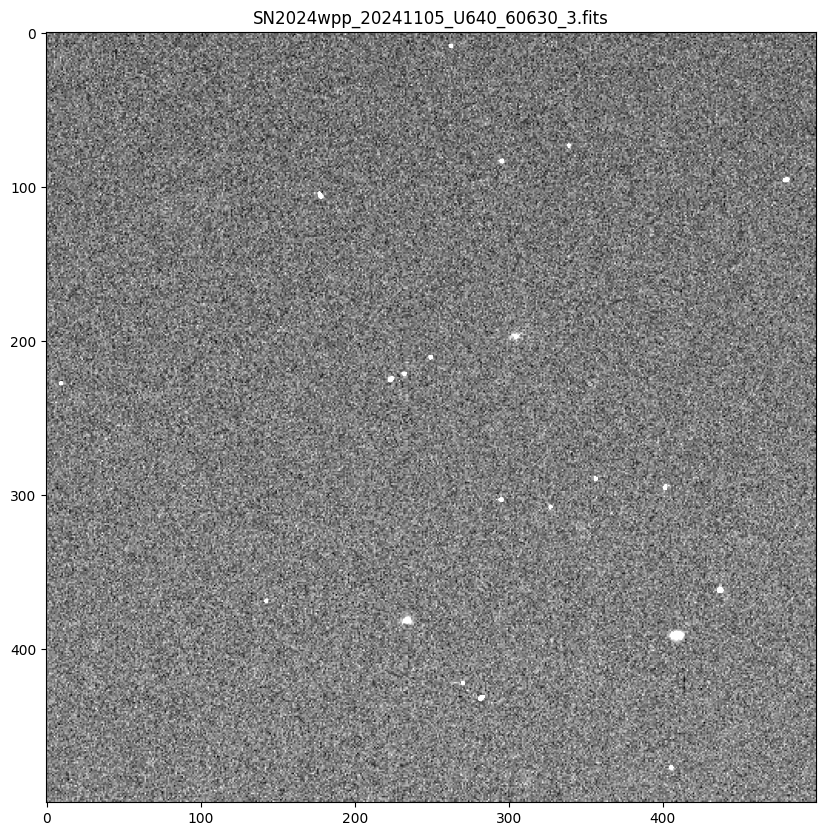

/mnt/data1/users/arikhind/phot_data/24wpp/20241105/SN2024wpp_20241105_U640_60630_4.fits


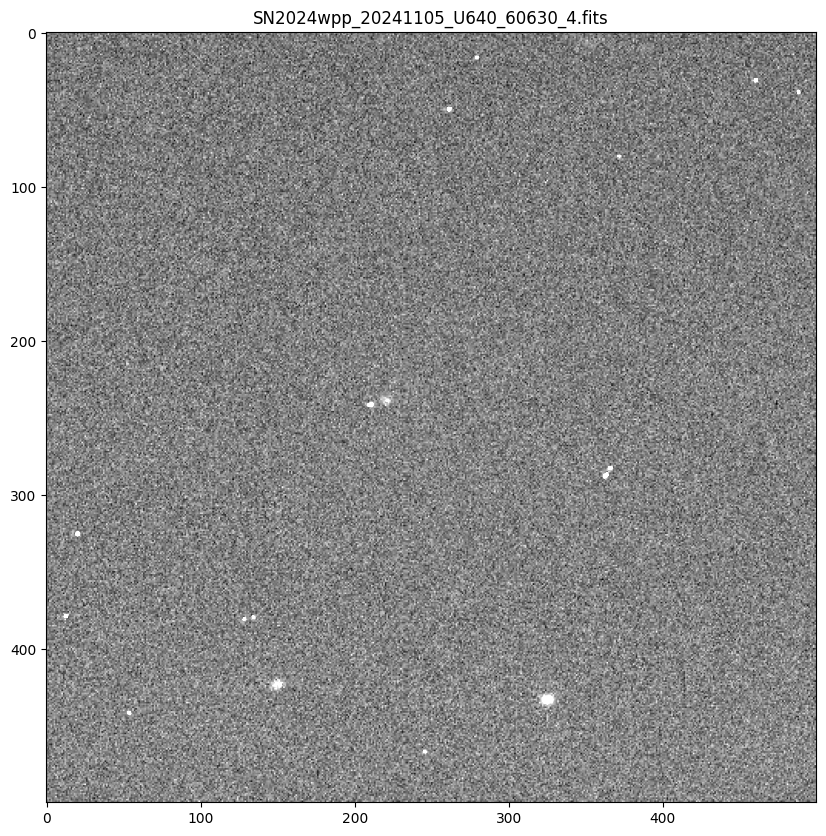

/mnt/data1/users/arikhind/phot_data/24wpp/20241105/SN2024wpp_20241105_U640_60630_5.fits


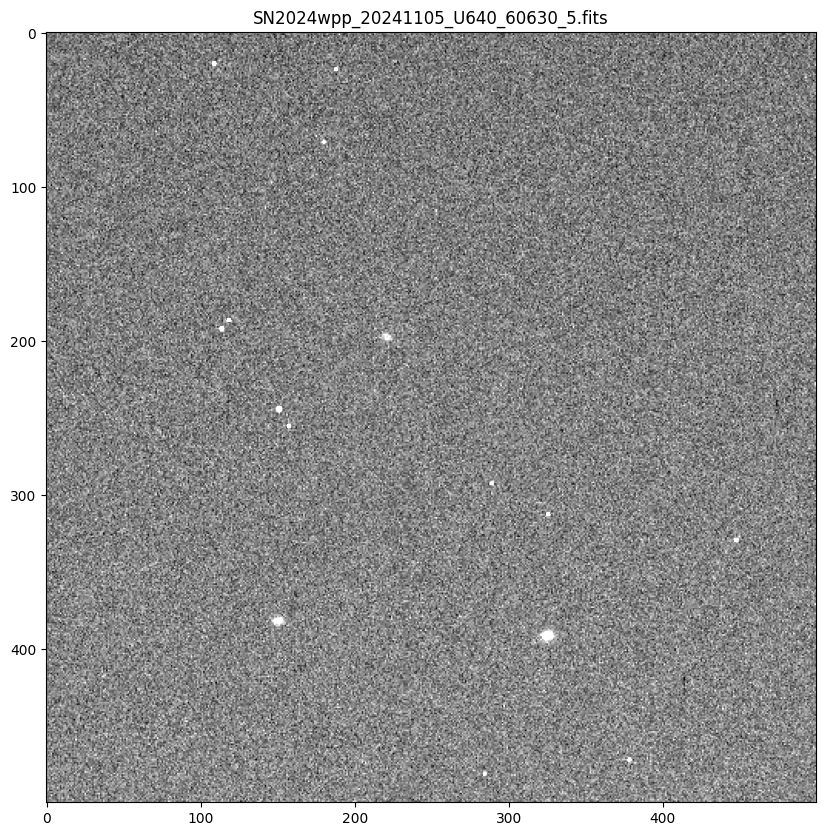

/mnt/data1/users/arikhind/phot_data/24wpp/20241105/SN2024wpp_20241105_i705_60630_1.fits


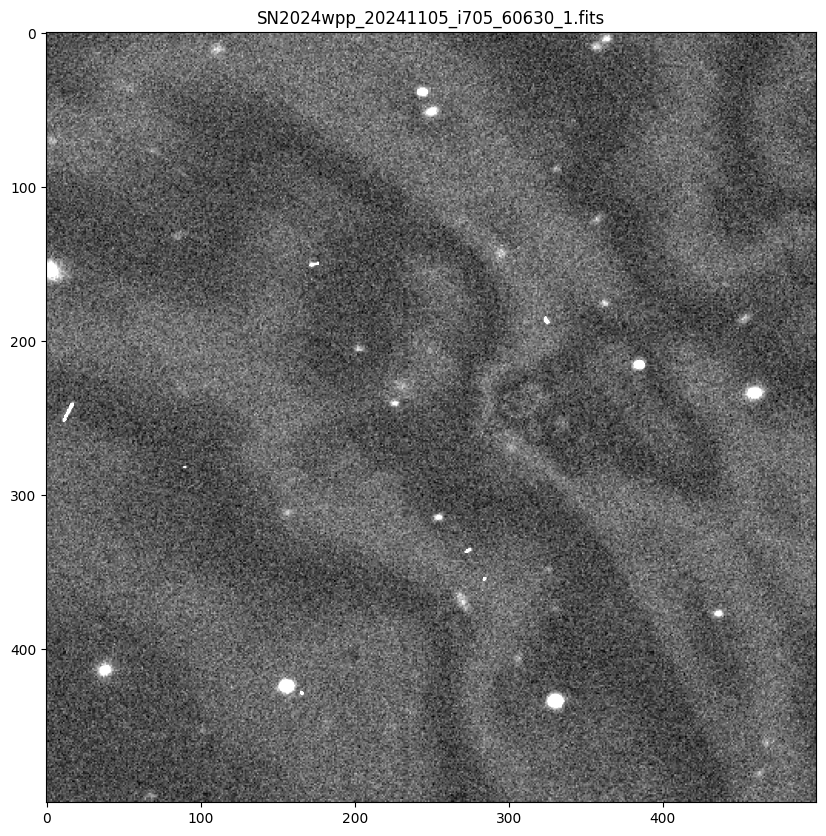

/mnt/data1/users/arikhind/phot_data/24wpp/20241105/SN2024wpp_20241105_i705_60630_1_fr.fits


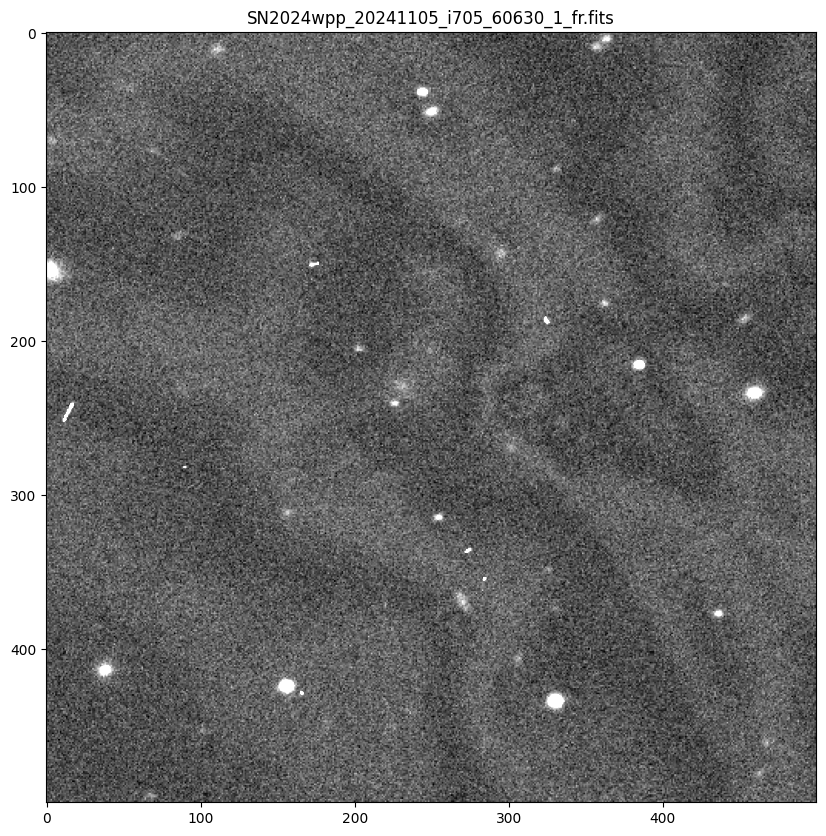

/mnt/data1/users/arikhind/phot_data/24wpp/20241105/SN2024wpp_20241105_i705_60630_2.fits


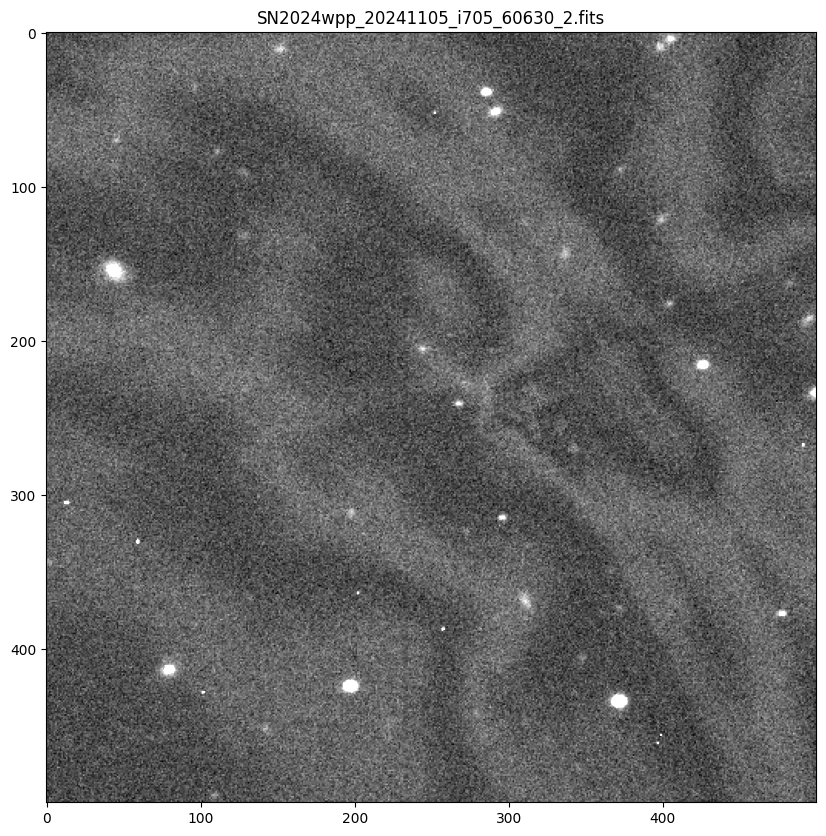

/mnt/data1/users/arikhind/phot_data/24wpp/20241105/SN2024wpp_20241105_i705_60630_2_fr.fits


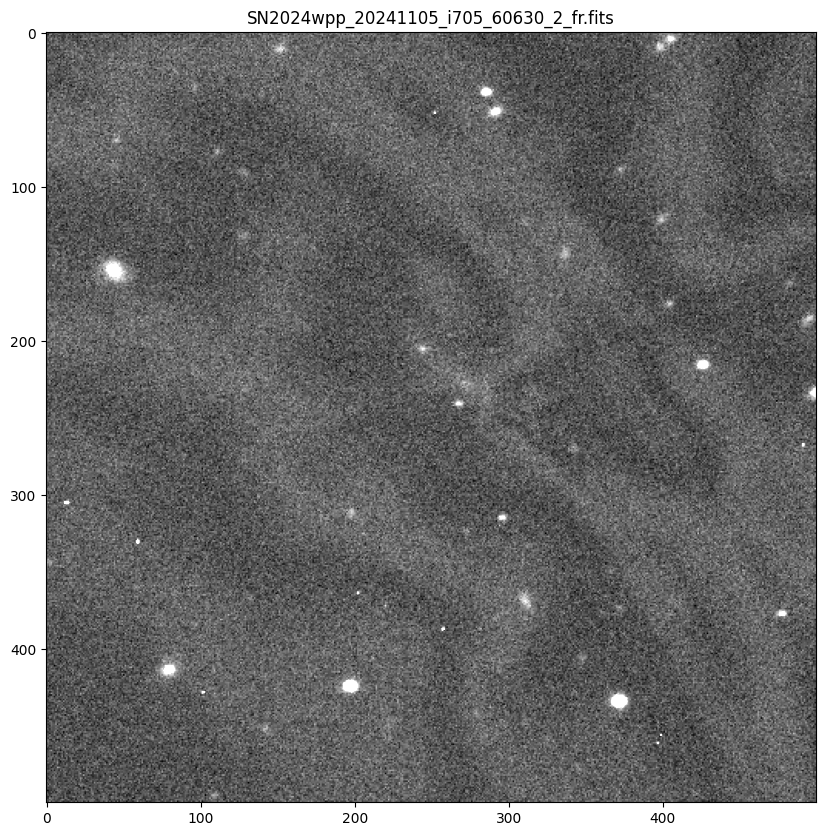

/mnt/data1/users/arikhind/phot_data/24wpp/20241105/SN2024wpp_20241105_i705_60630_3.fits


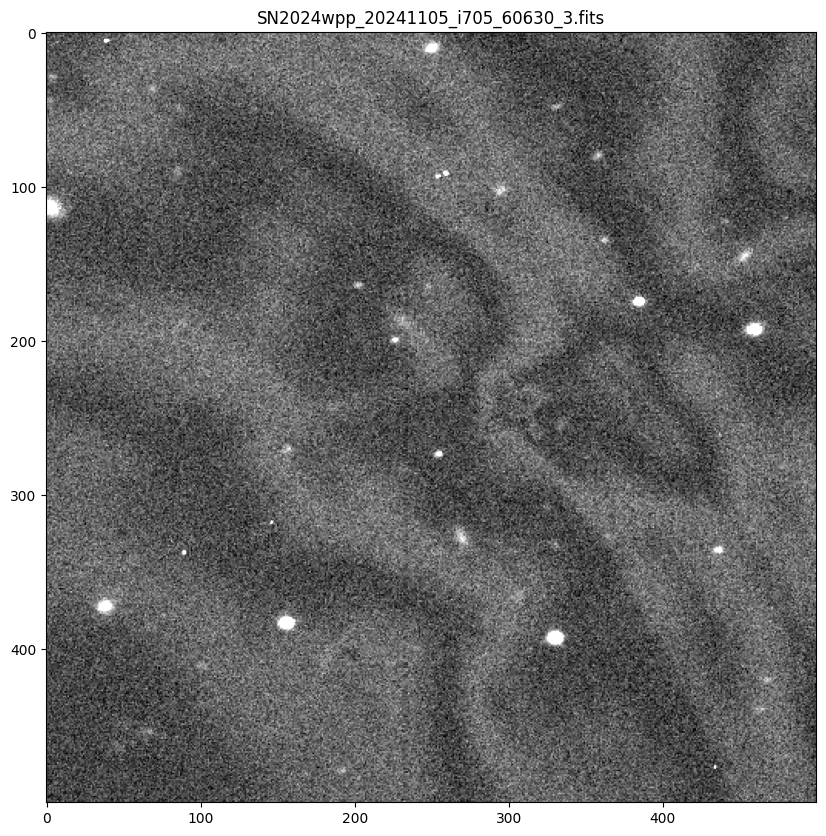

/mnt/data1/users/arikhind/phot_data/24wpp/20241105/SN2024wpp_20241105_i705_60630_3_fr.fits


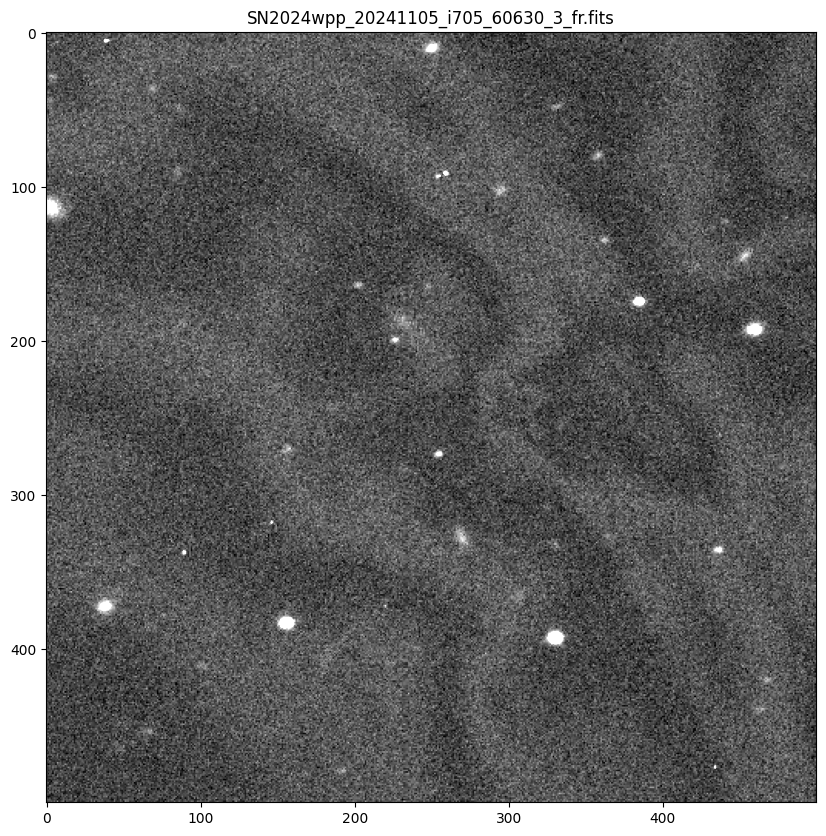

/mnt/data1/users/arikhind/phot_data/24wpp/20241105/SN2024wpp_20241105_z623_60630_1.fits


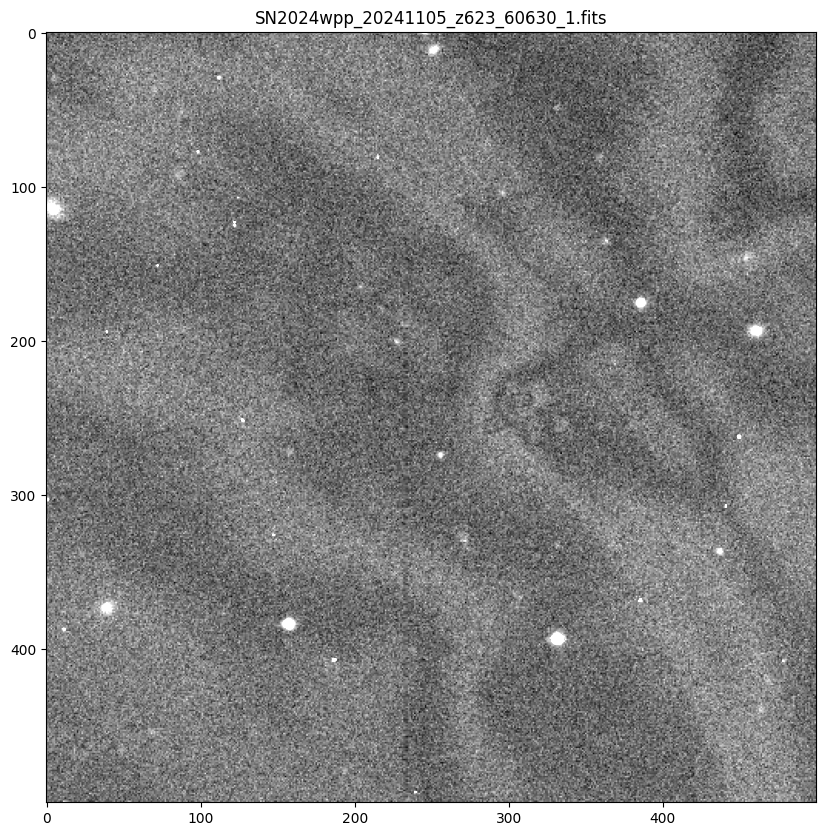

/mnt/data1/users/arikhind/phot_data/24wpp/20241105/SN2024wpp_20241105_z623_60630_2.fits


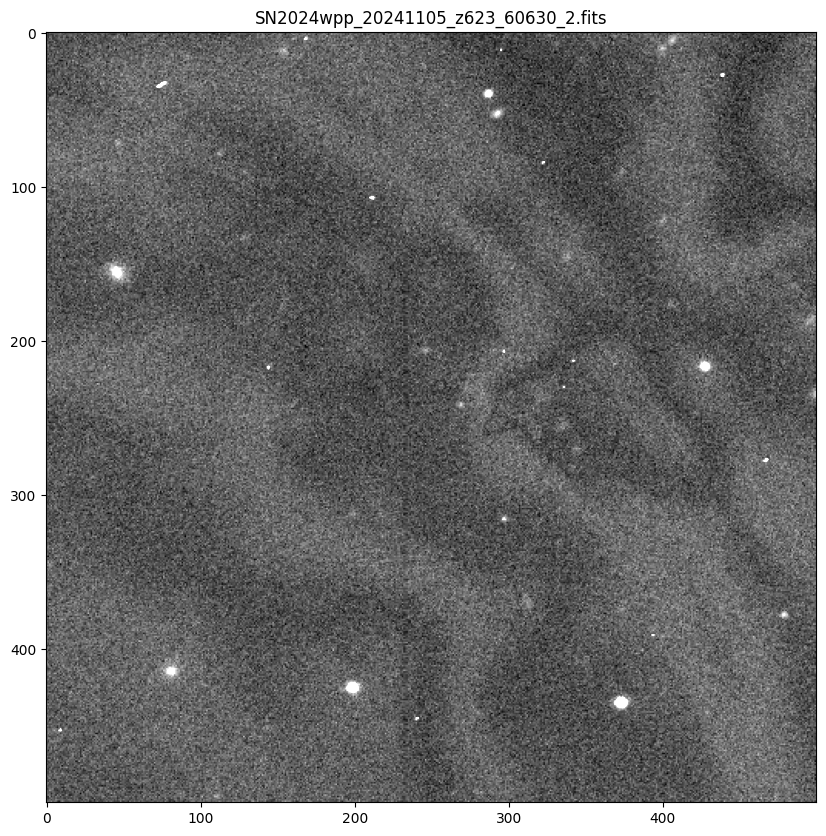

/mnt/data1/users/arikhind/phot_data/24wpp/20241105/SN2024wpp_20241105_z623_60630_3.fits


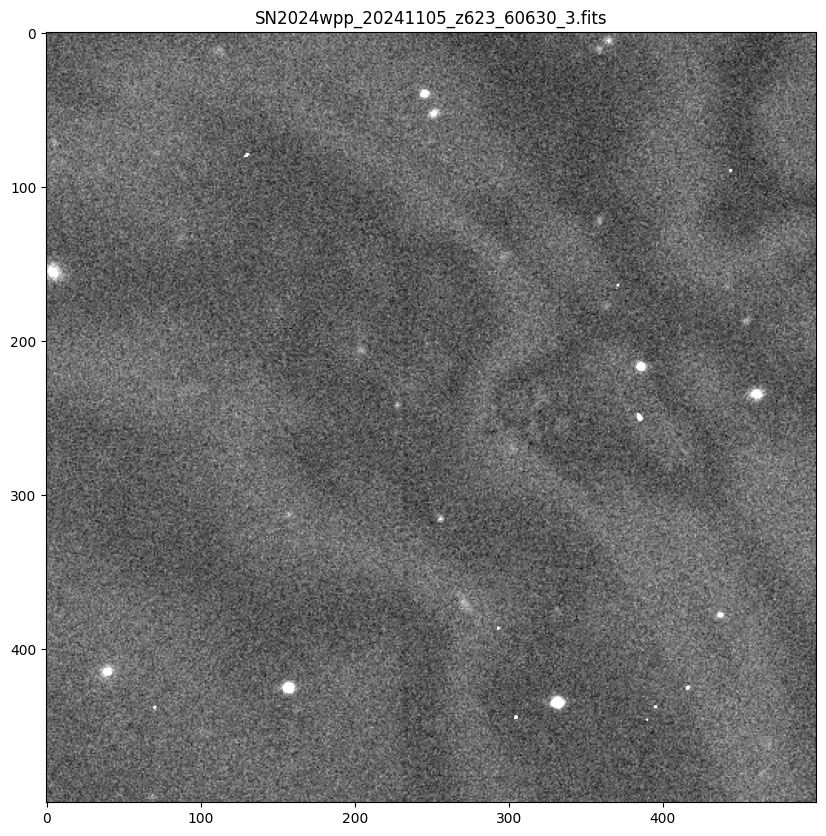

/mnt/data1/users/arikhind/phot_data/24wpp/20241105/SN2024wpp_20241105_g782_60630_1.fits


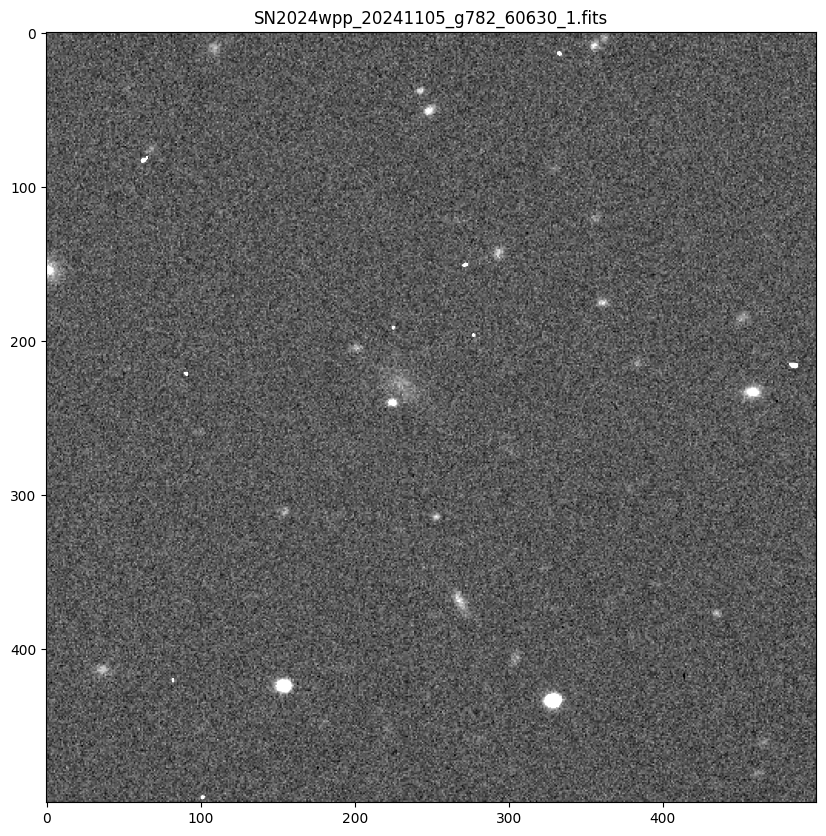

/mnt/data1/users/arikhind/phot_data/24wpp/20241105/SN2024wpp_20241105_g782_60630_2.fits


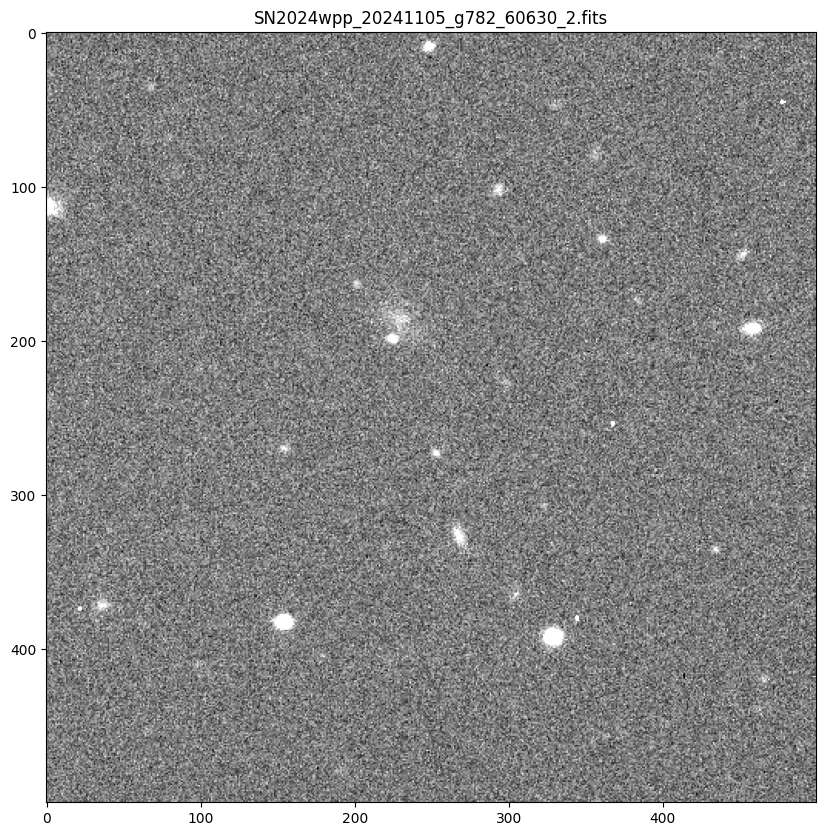

/mnt/data1/users/arikhind/phot_data/24wpp/20241105/SN2024wpp_20241105_g782_60630_3.fits


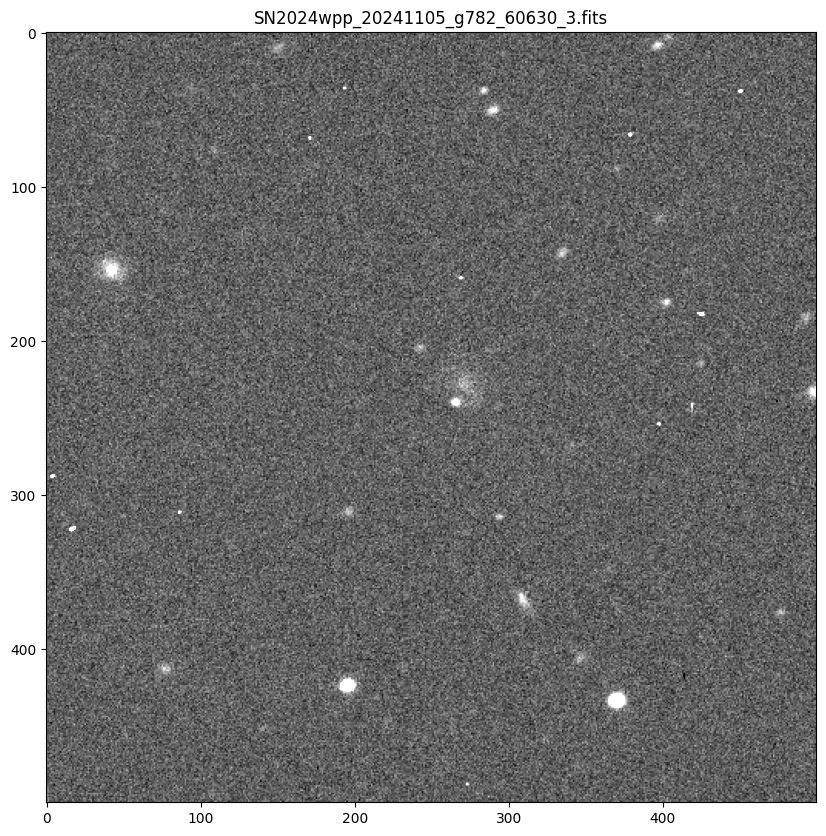

/mnt/data1/users/arikhind/phot_data/24wpp/20241105/SN2024wpp_20241105_r784_60630_1.fits


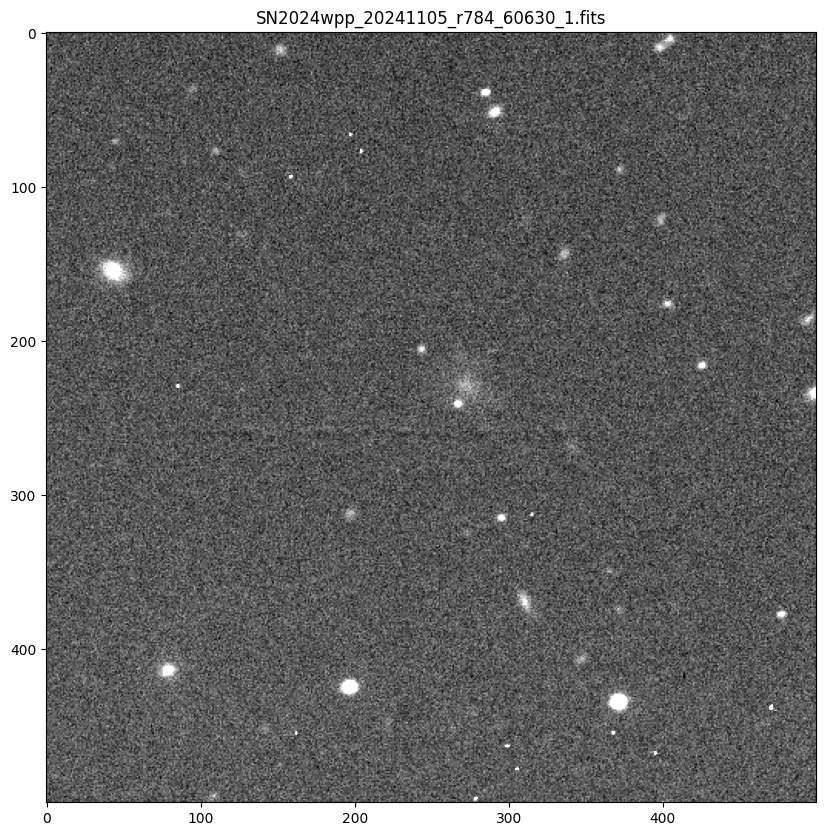

/mnt/data1/users/arikhind/phot_data/24wpp/20241105/SN2024wpp_20241105_r784_60630_2.fits


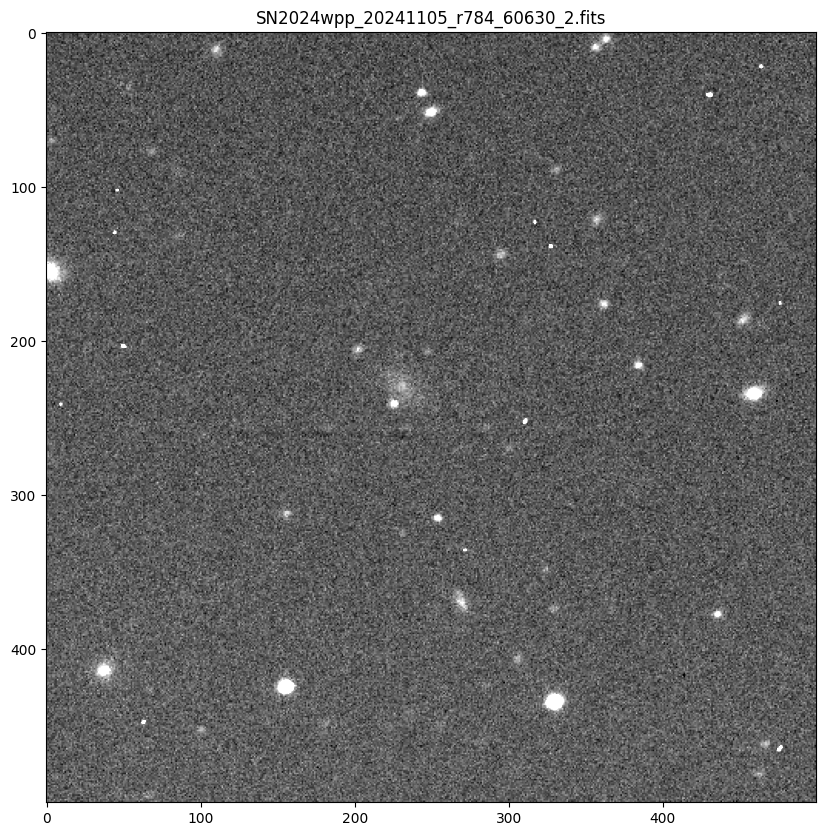

/mnt/data1/users/arikhind/phot_data/24wpp/20241105/SN2024wpp_20241105_r784_60630_3.fits


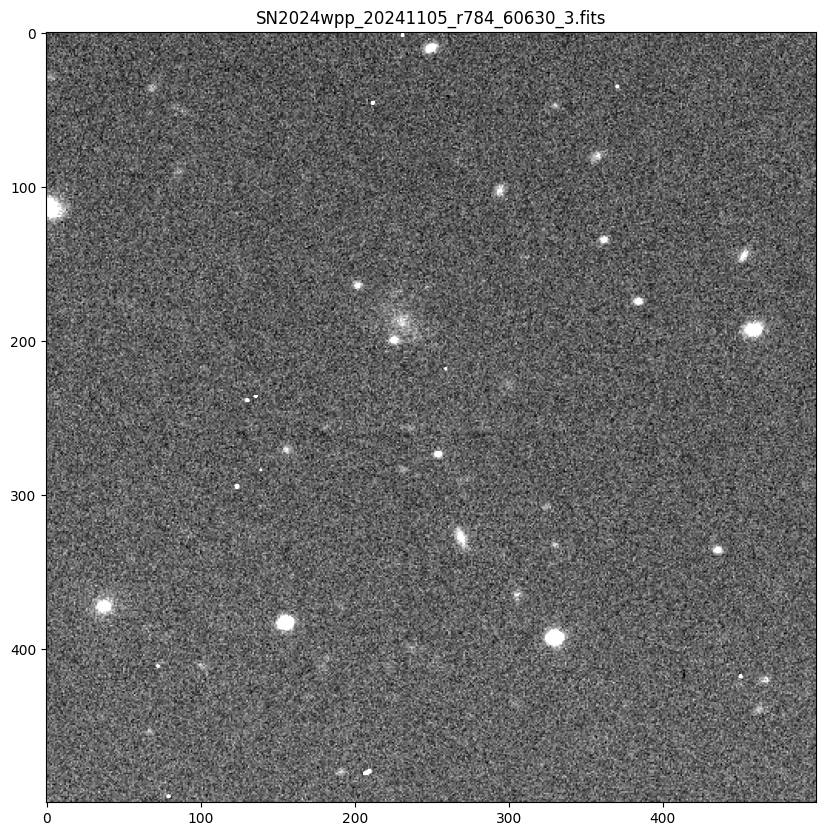

In [10]:
# for file in np.sort(archive_):
#   d = fits.open(file)[0]
#   print(file,d.header['ESO DPR TYPE'],d.header['ESO INS FILT1 NAME'])

for i in glob.glob('/mnt/data1/users/arikhind/phot_data/24wpp/20241105/SN20*'):
  # print(i)
  print(i)
  d = fits.open(i)[0].data
  fig = plt.figure(figsize=(10, 10))
  #put a circle at 500,500
  # plt.gca().add_artist(plt.Circle((500, 500), 10, fill=False, edgecolor='red'))

  vmin,vmax = visualization.ZScaleInterval().get_limits(d)
  plt.imshow(d[250:750,250:750], cmap='gray', vmin=vmin, vmax=vmax)
  plt.title(i.split('/')[-1])
  plt.show()
  # time.sleep(1)
  # plt.close()

In [ ]:
dark =[]
gskyflat,rskyflat,zskyflat,iskyflat,uskyflat = [],[],[],[],[]
domeflat = []
bias = []
for file in np.sort(fits_20241106_cal):
  d = fits.open(file)[0]
  if not np.shape(d.data)==(1030,1030):continue
  print(file,d.header['ESO DPR TYPE'],d.header['ESO INS FILT1 NAME'],np.shape(d.data))
  if d.header['ESO DPR TYPE']=='DARK':dark.append(file)
  if d.header['ESO DPR TYPE']=='BIAS':bias.append(file)
  if d.header['ESO DPR TYPE']=='SKY,FLAT':
    if 'g' in d.header['ESO INS FILT1 NAME']:gskyflat.append(file)
    if 'r' in d.header['ESO INS FILT1 NAME']:rskyflat.append(file)
    if 'z' in d.header['ESO INS FILT1 NAME']:zskyflat.append(file)
    if 'i' in d.header['ESO INS FILT1 NAME']:iskyflat.append(file)
    if 'U' in d.header['ESO INS FILT1 NAME']:uskyflat.append(file)
  # if d.header['ESO DPR TYPE']=='DOMEFLAT':domeflat.append(file)

print('BIAS:',len(bias))
print('DARK:',len(dark))
print('USKYFLAT:',len(uskyflat))
print('GSKYFLAT:',len(gskyflat))
print('RSKYFLAT:',len(rskyflat))
print('ISKYFLAT:',len(iskyflat))
print('ZSKYFLAT:',len(zskyflat))

/mnt/data1/users/arikhind/phot_data/NTT_2024wpp_raw/cal_20241106_24wpp/EFOSC.2024-11-05T17:42:57.862.fits DARK Free (1030, 1030)
/mnt/data1/users/arikhind/phot_data/NTT_2024wpp_raw/cal_20241106_24wpp/EFOSC.2024-11-05T17:43:28.773.fits DARK Free (1030, 1030)
/mnt/data1/users/arikhind/phot_data/NTT_2024wpp_raw/cal_20241106_24wpp/EFOSC.2024-11-05T17:43:59.795.fits DARK Free (1030, 1030)
/mnt/data1/users/arikhind/phot_data/NTT_2024wpp_raw/cal_20241106_24wpp/EFOSC.2024-11-05T17:44:30.767.fits DARK Free (1030, 1030)
/mnt/data1/users/arikhind/phot_data/NTT_2024wpp_raw/cal_20241106_24wpp/EFOSC.2024-11-05T17:45:01.719.fits DARK Free (1030, 1030)
/mnt/data1/users/arikhind/phot_data/NTT_2024wpp_raw/cal_20241106_24wpp/EFOSC.2024-11-05T17:45:32.771.fits DARK Free (1030, 1030)
/mnt/data1/users/arikhind/phot_data/NTT_2024wpp_raw/cal_20241106_24wpp/EFOSC.2024-11-05T17:46:03.813.fits DARK Free (1030, 1030)
/mnt/data1/users/arikhind/phot_data/NTT_2024wpp_raw/cal_20241106_24wpp/EFOSC.2024-11-05T17:46:34.

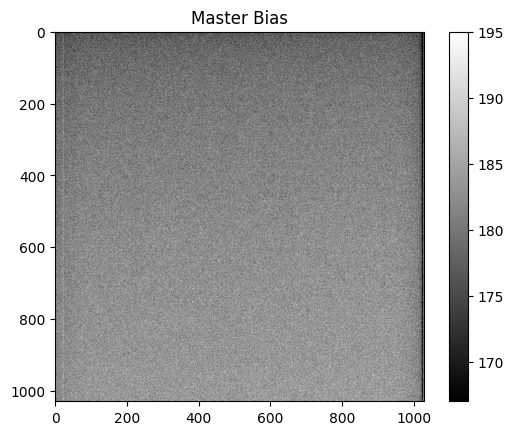

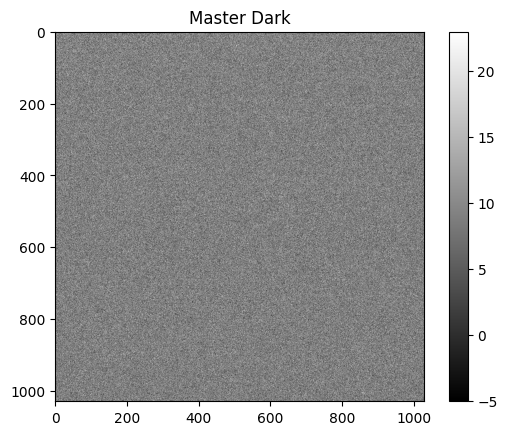

In [ ]:
master_bias = []

for file in bias:
  d = fits.open(file)[0]
  master_bias.append(d.data)

master_bias = np.median(np.array(master_bias),axis=0)
vmin,vmax = visualization.ZScaleInterval().get_limits(master_bias)
plt.imshow(master_bias,cmap='gray',vmin=vmin, vmax=vmax)
plt.colorbar()
#save the master bias
fits.writeto('/mnt/data1/users/arikhind/phot_data/NTT_2024wpp_reduced/master_cal/master_bias.fits',master_bias,overwrite=True)
plt.title('Master Bias')
plt.show()



master_dark = []
for file in dark:
  d = fits.open(file)[0]
  # print(file,d.header['ESO DPR TYPE'],np.shape(d.data))
  master_dark.append(d.data)

# print(master_dark)
master_dark = np.median(np.array(master_dark),axis=0) - master_bias
vmin,vmax = visualization.ZScaleInterval().get_limits(master_dark)
plt.imshow(master_dark,cmap='gray',vmin=vmin, vmax=vmax)
plt.colorbar()
plt.title('Master Dark')
#save the master dark
fits.writeto('/mnt/data1/users/arikhind/phot_data/NTT_2024wpp_reduced/master_cal/master_dark.fits',master_dark,overwrite=True)
plt.show()

In [ ]:
master_uflat,master_gflat,master_rflat,master_zflat,master_iflat = [],[],[],[],[]

for file in uskyflat:
  d = fits.open(file)[0]
  master_uflat.append(d.data/np.median(d.data))

for file in gskyflat:
  d = fits.open(file)[0]
  master_gflat.append(d.data/np.median(d.data))

for file in rskyflat:
  d = fits.open(file)[0]
  master_rflat.append(d.data/np.median(d.data))

for file in zskyflat:
  d = fits.open(file)[0]
  master_zflat.append(d.data/np.median(d.data))

for file in iskyflat:
  d = fits.open(file)[0]
  master_iflat.append(d.data/np.median(d.data))


master_uflat = np.median(np.array(master_uflat),axis=0)
master_gflat = np.median(np.array(master_gflat),axis=0)
master_rflat = np.median(np.array(master_rflat),axis=0)
master_zflat = np.median(np.array(master_zflat),axis=0)
master_iflat = np.median(np.array(master_iflat),axis=0)

master_uflat = master_uflat - master_bias - master_dark
master_gflat = master_gflat - master_bias - master_dark
master_rflat = master_rflat - master_bias - master_dark
master_zflat = master_zflat - master_bias - master_dark
master_iflat = master_iflat - master_bias - master_dark


vmin,vmax = visualization.ZScaleInterval().get_limits(master_uflat)
plt.imshow(master_uflat,cmap='gray',vmin=vmin, vmax=vmax)
plt.colorbar()
plt.title('Master USKYFLAT')
#save the master uflat
fits.writeto('/mnt/data1/users/arikhind/phot_data/NTT_2024wpp_reduced/master_cal/master_uflat.fits',master_uflat,overwrite=True)
plt.show()

vmin,vmax = visualization.ZScaleInterval().get_limits(master_gflat)
plt.imshow(master_gflat,cmap='gray',vmin=vmin, vmax=vmax)
plt.colorbar()
plt.title('Master GSKYFLAT')
#save the master gflat
fits.writeto('/mnt/data1/users/arikhind/phot_data/NTT_2024wpp_reduced/master_cal/master_gflat.fits',master_gflat,overwrite=True)
plt.show()

vmin,vmax = visualization.ZScaleInterval().get_limits(master_rflat)
plt.imshow(master_rflat,cmap='gray',vmin=vmin, vmax=vmax)
plt.colorbar()
plt.title('Master RSKYFLAT')
#save the master rflat
fits.writeto('/mnt/data1/users/arikhind/phot_data/NTT_2024wpp_reduced/master_cal/master_rflat.fits',master_rflat,overwrite=True)
plt.show()

vmin,vmax = visualization.ZScaleInterval().get_limits(master_zflat)
plt.imshow(master_zflat,cmap='gray',vmin=vmin, vmax=vmax)
plt.colorbar()
plt.title('Master ZSKYFLAT')
#save the master zflat

In [ ]:

for file in fits_20241106:#[::-1]:
  d = fits.open(file)[0]
  f = d.header['ESO INS FILT1 NAME']
  # if not any(i in f for i in ['z']):continue

  # fig = plt.figure(figsize=(6,6))
  # vmin,vmax = visualization.ZScaleInterval().get_limits(d.data)
  # # for k,i in d.header.items():
  # #   if 'FILT' in k:
  # #     print(k,i)
  # plt.imshow(d.data,cmap='gray',vmin=vmin, vmax=vmax)
  # plt.title(file.split('/')[-1]+' '+f)
  print(file,d.header['ESO DPR TYPE'],d.header['ESO INS FILT1 NAME'],np.shape(d.data))
  
  # break


/mnt/data1/users/arikhind/phot_data/NTT_2024wpp/20241106_24wpp_phot/EFOSC.2024-11-06T05:33:17.702.fits STD g#782 (1030, 1030)
/mnt/data1/users/arikhind/phot_data/NTT_2024wpp/20241106_24wpp_phot/EFOSC.2024-11-06T05:34:10.661.fits STD r#784 (1030, 1030)
/mnt/data1/users/arikhind/phot_data/NTT_2024wpp/20241106_24wpp_phot/EFOSC.2024-11-06T05:34:57.920.fits STD z#623 (1030, 1030)
/mnt/data1/users/arikhind/phot_data/NTT_2024wpp/20241106_24wpp_phot/EFOSC.2024-11-06T05:32:32.144.fits STD i#705 (1030, 1030)
/mnt/data1/users/arikhind/phot_data/NTT_2024wpp/20241106_24wpp_phot/EFOSC.2024-11-06T01:14:48.293.fits OBJECT U#640 (1030, 1030)
/mnt/data1/users/arikhind/phot_data/NTT_2024wpp/20241106_24wpp_phot/EFOSC.2024-11-06T01:18:49.886.fits OBJECT U#640 (1030, 1030)
/mnt/data1/users/arikhind/phot_data/NTT_2024wpp/20241106_24wpp_phot/EFOSC.2024-11-06T01:22:50.498.fits OBJECT U#640 (1030, 1030)
/mnt/data1/users/arikhind/phot_data/NTT_2024wpp/20241106_24wpp_phot/EFOSC.2024-11-06T01:26:51.089.fits OBJECT